In [ ]:
import os, io, random, time
from collections import defaultdict
import numpy as np
from typing import Optional
import torch
from torch.utils.data import DataLoader, Subset
import torch.nn as nn
from torchvision import transforms
from PIL import Image as PILImage
from datasets import load_dataset
from datasets import Image as HFImage
import math
from collections import defaultdict
import colorsys

os.environ["OMP_NUM_THREADS"] = "1"
os.environ["MKL_NUM_THREADS"] = "1"
torch.set_num_threads(1)
torch.backends.cudnn.benchmark = True

# Configuración
BATCH_SIZE   = 45
PIN_MEMORY   = True
DROP_LAST    = True
SEED         = 7

# Tamaño de entrenamiento
SIZE         = 256
FINAL_SIZE   = 252  # usamos RandomResizedCrop directo a 252

# Targets de reducción (ajusta a gusto)
CONTENT_KEEP = 10000   # COCO
STYLE_KEEP   = 30000   # WikiArt

# Normalización ImageNet
IMAGENET_MEAN = [0.485, 0.456, 0.406]
IMAGENET_STD  = [0.229, 0.224, 0.225]

# Auto-select de workers (Kaggle suele tener 2 vCPU)
CPU_COUNT = os.cpu_count() or 2
NUM_WORKERS = 0
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"


# ============================================
# Semillas
# ============================================
def set_seed(seed=SEED):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)

def worker_seed_init(worker_id: int):
    seed = (torch.initial_seed() + worker_id) % 2**32
    np.random.seed(seed); random.seed(seed)

set_seed(SEED)

# ============================================
# Transforms (limpios)
# ============================================
content_tf = transforms.Compose([
    transforms.RandomResizedCrop(FINAL_SIZE, scale=(0.5, 1.0)),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.ToTensor(),
    transforms.Normalize(IMAGENET_MEAN, IMAGENET_STD),])

style_tf = transforms.Compose([
    transforms.RandomResizedCrop(FINAL_SIZE, scale=(0.7, 1.0)),
    transforms.RandomHorizontalFlip(p=0.2),
    transforms.ToTensor(),
    transforms.Normalize(IMAGENET_MEAN, IMAGENET_STD),])


# ============================================
# Utilidades HF / PIL
# ============================================
def detect_image_col(ds):
    for c in ["image", "coco_url", "url", "image_url", "filepath", "file_name", "path"]:
        if c in ds.column_names:
            return c
    raise RuntimeError(f"No image-like column found. Columns: {ds.column_names}")

def is_valid_image_entry(x):
    if x is None: return False
    if isinstance(x, list):
        if len(x) == 0: return False
        x = x[0]
    if hasattr(x, "size"):  # PIL.Image
        return True
    if isinstance(x, dict):
        return ("bytes" in x and x["bytes"] is not None) or ("path" in x and x["path"])
    if isinstance(x, (bytes, bytearray)): return True
    if isinstance(x, str): return x.startswith("http") or os.path.exists(x)
    return False

def filter_valid_images(ds, img_key):
    return ds.filter(lambda ex: is_valid_image_entry(ex[img_key]), num_proc=1)

def cast_to_image(ds, col_name):
    if col_name != "image":
        ds = ds.cast_column(col_name, HFImage(decode=True))
        ds = ds.rename_column(col_name, "image")
    else:
        ds = ds.cast_column("image", HFImage(decode=True))
    return ds

def to_pil(x):
    if isinstance(x, list) and len(x) > 0:
        x = x[0]
    if hasattr(x, "size"):  # PIL
        return x.convert("RGB")
    if isinstance(x, dict) and "bytes" in x and x["bytes"] is not None:
        return PILImage.open(io.BytesIO(x["bytes"])).convert("RGB")
    if isinstance(x, dict) and "path" in x and x["path"]:
        return PILImage.open(x["path"]).convert("RGB")
    if isinstance(x, (bytes, bytearray)):
        return PILImage.open(io.BytesIO(x)).convert("RGB")
    if isinstance(x, str) and (x.startswith("http") or os.path.exists(x)):
        return PILImage.open(x).convert("RGB")
    raise TypeError(f"No pude convertir a PIL: tipo={type(x)}")


# ============================================
# Dataset wrapper + collate
# ============================================
class HFDataset(torch.utils.data.Dataset):
    def __init__(self, hf_ds, img_key: str, transform):
        self.ds = hf_ds
        self.img_key = img_key
        self.tfm = transform
    def __len__(self):
        return self.ds.num_rows
    def __getitem__(self, idx):
        ex = self.ds[idx]
        img = to_pil(ex[self.img_key])
        return self.tfm(img)

def collate_pixels(batch):
    return torch.stack(batch, dim=0)

# ============================================
# DataLoader optimizado
# ============================================
def make_loader(ds, batch_size=BATCH_SIZE, num_workers=NUM_WORKERS, pin=PIN_MEMORY,
                drop_last=DROP_LAST, collate_fn=collate_pixels):
    return DataLoader(
        ds,
        batch_size=batch_size,
        shuffle=True,
        num_workers=num_workers,
        pin_memory=pin,
        drop_last=drop_last,
        collate_fn=collate_fn,
        persistent_workers=(num_workers > 0),
        prefetch_factor=4 if num_workers > 0 else None,
        worker_init_fn=worker_seed_init)

# ============================================
# Iterador dual (content + style)
# ============================================
def infinite_cycle(loader):
    while True:
        for batch in loader:
            yield batch

class DualBatchIterator:
    def __init__(self, content_loader, style_loader):
        self.content_loader = content_loader
        self.style_iter = infinite_cycle(style_loader)

    def __iter__(self):
        for xb_content in self.content_loader:
            xb_style = next(self.style_iter)
            if xb_style.size(0) != xb_content.size(0):
                b = xb_content.size(0)
                if xb_style.size(0) > b:
                    xb_style = xb_style[:b]
                else:
                    idx = torch.randint(0, xb_style.size(0), (b,), device=xb_style.device)
                    xb_style = xb_style.index_select(0, idx)
            yield xb_content, xb_style

def make_train_iterator(content_loader, style_loader):
    return DualBatchIterator(content_loader, style_loader)




# Recorte (uniforme) de datasets
def truncate_dataloaders(content_loader: DataLoader,
                         style_loader: Optional[DataLoader] = None,
                         n: int = 60000,
                         seed: int = 77):
    rng = np.random.default_rng(seed)

    def sample_indices(ds_len, n_keep):
        n_keep = min(int(n_keep), int(ds_len))
        return rng.choice(ds_len, size=n_keep, replace=False)

    def shrink_dataset_from_loader(loader, n_keep):
        ds = loader.dataset
        if hasattr(ds, "ds"):  # nuestro HFDataset envuelve a HF ds como ds.ds
            base = ds.ds
            idx = sample_indices(len(base), n_keep)
            base_small = base.select(idx.tolist())
            ds_small = type(ds)(base_small, img_key=ds.img_key, transform=ds.tfm)
        else:
            idx = sample_indices(len(ds), n_keep)
            ds_small = Subset(ds, idx)

        return make_loader(
            ds_small,
            batch_size=loader.batch_size,
            num_workers=loader.num_workers,
            pin=loader.pin_memory,
            drop_last=loader.drop_last,
            collate_fn=loader.collate_fn
        )

    content_small = shrink_dataset_from_loader(content_loader, n)
    if style_loader is None:
        return content_small
    style_small = shrink_dataset_from_loader(style_loader, n)
    return content_small, style_small

# ============================================
# Submuestreo de Wiki
# ============================================

# Submuestreo estratificado para WikiArt
def stratified_pick(hf_ds, group_col: str, target_total: int, seed: int = 77, min_per_group: int = 1):
    if group_col not in hf_ds.column_names:
        raise ValueError(f"'{group_col}' no está en {hf_ds.column_names}")
    rng = np.random.default_rng(seed)

    buckets = defaultdict(list)
    for i, g in enumerate(hf_ds[group_col]):
        if g is not None:
            buckets[g].append(i)

    G = len(buckets)
    if G == 0:
        # fallback: muestreo uniforme
        n = min(target_total, len(hf_ds))
        return rng.choice(len(hf_ds), size=n, replace=False).tolist()

    # per-group ideal (redondeo hacia arriba para no quedarnos cortos)
    per_group = max(min_per_group, math.ceil(target_total / G))

    picked = []
    for _, idxs in buckets.items():
        if len(picked) >= target_total:
            break
        if len(idxs) <= per_group:
            picked.extend(idxs)
        else:
            picked.extend(rng.choice(idxs, size=per_group, replace=False).tolist())

    # si nos pasamos un poco, recortamos
    if len(picked) > target_total:
        picked = rng.choice(picked, size=target_total, replace=False).tolist()

    return sorted(picked)


def compute_style_metrics(pil_img: PILImage.Image):
    """
    Calcula métricas sencillas de:
      - brillo medio y contraste (std)
      - gradiente (borde / textura)
      - saturación media y std (en HSV)
    La imagen se reduce a 128x128 para que sea rápido.
    """
    img = pil_img.convert("RGB").resize((128, 128))
    arr = np.asarray(img).astype(np.float32) / 255.0  # [H,W,3]

    # Escala de grises (para brillo / contraste y gradiente)
    gray = 0.299 * arr[..., 0] + 0.587 * arr[..., 1] + 0.114 * arr[..., 2]  # [128,128]

    bright_mean = float(gray.mean())
    bright_std  = float(gray.std())

    # Diferencias horizontales y verticales
    gx = gray[:, 1:] - gray[:, :-1]
    gy = gray[1:, :] - gray[:-1, :]

    # Recortamos para que ambos tengan la misma shape
    gx = gx[1:, :]
    gy = gy[:, 1:]

    grad_mag = np.sqrt(gx ** 2 + gy ** 2)
    grad_mean = float(grad_mag.mean())
    grad_std  = float(grad_mag.std())

    flat_rgb = arr.reshape(-1, 3)
    hsv = np.array(
        [colorsys.rgb_to_hsv(float(r), float(g), float(b)) for (r, g, b) in flat_rgb],
        dtype=np.float32)

    s = hsv[:, 1]
    sat_mean = float(s.mean())
    sat_std  = float(s.std())

    return {
        "bright_mean": bright_mean,
        "bright_std":  bright_std,
        "grad_mean":   grad_mean,
        "grad_std":    grad_std,
        "sat_mean":    sat_mean,
        "sat_std":     sat_std}

def add_style_metrics(example, img_col: str):
    pil_img = to_pil(example[img_col])
    m = compute_style_metrics(pil_img)
    example.update(m)
    return example


def is_good_style(example):
    """
    Heurística robusta para quedarnos con pinturas con:
      - brillo razonable (no casi negro ni lavado)
      - contraste en luminancia suficiente
      - textura/bordes suficientes
      - saturación con variación (no gris ni plano)
    Los umbrales son aproximados y se pueden tunear.
    """
    bm = example["bright_mean"]
    bs = example["bright_std"]
    gm = example["grad_mean"]
    gs = example["grad_std"]
    ss = example["sat_std"]

    # brillo: ni demasiado oscuro ni demasiado blanco
    if not (0.20 < bm < 0.85):
        return False

    # contraste (en luminancia)
    if bs < 0.08:
        return False

    # textura/borde (gradiente medio y std)
    if gm < 0.08 or gs < 0.02:
        return False

    # variación de saturación (evita imágenes casi grises o planas)
    if ss < 0.10:
        return False

    return True

# ============================================
# Carga de COCO (content) y WikiArt (style) desde HuggingFace
# ============================================

# COCO
coco_hf = load_dataset("phiyodr/coco2017", split="train")
coco_img_col = detect_image_col(coco_hf)
coco_hf = filter_valid_images(coco_hf, coco_img_col)
coco_hf = cast_to_image(coco_hf, coco_img_col)
coco_ds = HFDataset(coco_hf, img_key="image", transform=content_tf)
content_loader = make_loader(coco_ds, batch_size=BATCH_SIZE, num_workers=NUM_WORKERS)


# WIKIART: estratificado + heurística de textura/estilo
wiki_hf = load_dataset("davanstrien/wikiart-resized", split="train")
wiki_img_col = detect_image_col(wiki_hf)
wiki_hf = filter_valid_images(wiki_hf, wiki_img_col)

# Estratificar primero (por artista; si no, por estilo) a un pool de 30k
RAW_STYLE_POOL = 30000   # pool inicial grande
TARGET_GOOD    = 10000   # máximo final de pinturas

try:
    idx_pool = stratified_pick(wiki_hf, group_col="artist", target_total=RAW_STYLE_POOL, seed=77)
except ValueError:
    idx_pool = stratified_pick(wiki_hf, group_col="style", target_total=RAW_STYLE_POOL, seed=77)

wiki_pool = wiki_hf.select(idx_pool)
wiki_pool = cast_to_image(wiki_pool, wiki_img_col)

# Añadir métricas de estilo (esto recorre ~30k imágenes)
wiki_pool = wiki_pool.map(
    lambda ex: add_style_metrics(ex, img_col="image"),
    num_proc=1 )

# Filtrar por heurística
wiki_good = wiki_pool.filter(is_good_style, num_proc=1)

print("Total en pool estratificado:", len(wiki_pool))
print("Total de pinturas 'buenas' según heurística:", len(wiki_good))

# Si hay más de TARGET_GOOD, recortamos de forma estratificada de nuevo
if len(wiki_good) > TARGET_GOOD:
    try:
        idx_good = stratified_pick(wiki_good, group_col="artist", target_total=TARGET_GOOD, seed=77)
    except ValueError:
        idx_good = stratified_pick(wiki_good, group_col="style", target_total=TARGET_GOOD, seed=77)
    wiki_good = wiki_good.select(idx_good)

print("Total final de estilos usados para NST:", len(wiki_good))

wiki_ds = HFDataset(wiki_good, img_key="image", transform=style_tf)
style_loader = make_loader(wiki_ds, batch_size=BATCH_SIZE, num_workers=NUM_WORKERS)


content_loader = truncate_dataloaders(content_loader, None, n=CONTENT_KEEP, seed=77)
style_loader  = truncate_dataloaders(style_loader,  None, n=STYLE_KEEP,   seed=77)

train_iter = make_train_iterator(content_loader, style_loader)
xb_c, xb_s = next(iter(train_iter))
print("paired content:", xb_c.shape, "| paired style:", xb_s.shape)
print("len(content_loader) =", len(content_loader))

In [3]:
def analyze_loader(name, loader):
    print(f"\n===== Análisis del loader: {name} =====")

    total_imgs = len(loader.dataset)
    print(f"Total de imágenes: {total_imgs}")

    num_batches = len(loader)
    print(f"Número de batches: {num_batches}")

    batch = next(iter(loader))
    print(f"Batch shape: {batch.shape}")
    print(f"dtype: {batch.dtype}")

    print(f"min pixel: {batch.min().item():.4f}")
    print(f"max pixel: {batch.max().item():.4f}")
    print(f"mean: {batch.mean().item():.4f}")
    print(f"std:  {batch.std().item():.4f}")

    print("NaNs:", torch.isnan(batch).any().item())
    print("Infs:", torch.isinf(batch).any().item())

    print("mean por canal:", batch.mean(dim=(0,2,3)))
    print("std por canal:", batch.std(dim=(0,2,3)))


analyze_loader("CONTENT (COCO)", content_loader)
analyze_loader("STYLE (WikiArt)", style_loader)


===== Análisis del loader: CONTENT (COCO) =====
Total de imágenes: 10000
Número de batches: 222
Batch shape: torch.Size([45, 3, 252, 252])
dtype: torch.float32
min pixel: -2.1179
max pixel: 2.6400
mean: 0.0673
std:  1.1800
NaNs: False
Infs: False
mean por canal: tensor([0.0052, 0.0841, 0.1126])
std por canal: tensor([1.1530, 1.1677, 1.2158])

===== Análisis del loader: STYLE (WikiArt) =====
Total de imágenes: 3076
Número de batches: 68
Batch shape: torch.Size([45, 3, 252, 252])
dtype: torch.float32
min pixel: -2.1179
max pixel: 2.6400
mean: 0.1556
std:  1.0528
NaNs: False
Infs: False
mean por canal: tensor([0.2465, 0.1734, 0.0471])
std por canal: tensor([1.0922, 1.0365, 1.0186])


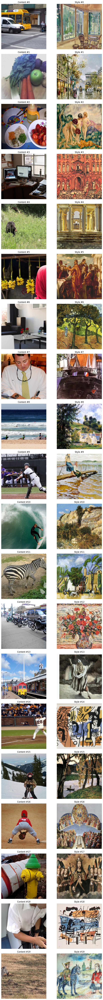

In [4]:
import matplotlib.pyplot as plt

IMAGENET_MEAN = torch.tensor([0.485, 0.456, 0.406]).view(3,1,1)
IMAGENET_STD  = torch.tensor([0.229, 0.224, 0.225]).view(3,1,1)

def denorm(x):
    """x: tensor [3,H,W] normalizado → tensor [H,W,3] en [0,1]"""
    x = x.cpu() * IMAGENET_STD + IMAGENET_MEAN
    x = x.clamp(0,1)
    return x.permute(1,2,0).numpy()

def show_examples(train_iter, num_pairs=5):
    """
    Muestra num_pairs de pares (content, style) obtenidos del DualBatchIterator.
    """
    x_content, x_style = next(iter(train_iter))
    num_pairs = min(num_pairs, x_content.size(0), x_style.size(0))

    plt.figure(figsize=(10, 4*num_pairs))

    for i in range(num_pairs):

        plt.subplot(num_pairs, 2, 2*i + 1)
        plt.imshow(denorm(x_content[i]))
        plt.title(f"Content #{i}")
        plt.axis("off")

        plt.subplot(num_pairs, 2, 2*i + 2)
        plt.imshow(denorm(x_style[i]))
        plt.title(f"Style #{i}")
        plt.axis("off")

    plt.tight_layout()
    plt.show()

show_examples(train_iter, num_pairs=20)

In [ ]:
import os, io, random, time
from collections import defaultdict
import numpy as np
from typing import Optional
import torch
from torch.utils.data import DataLoader, Subset
import torch.nn as nn
from torchvision import transforms
from PIL import Image as PILImage
from datasets import load_dataset
from datasets import Image as HFImage
import math
from collections import defaultdict

# ======================================================
# Configuración
# ======================================================
os.environ["OMP_NUM_THREADS"] = "1"
os.environ["MKL_NUM_THREADS"] = "1"
torch.set_num_threads(1)
torch.backends.cudnn.benchmark = True

BATCH_SIZE   = 45
PIN_MEMORY   = True
DROP_LAST    = True
SEED         = 7

# Tamaño de entrenamiento
SIZE       = 256
FINAL_SIZE = 252  # usamos RandomResizedCrop directo a 252

# Targets de reducción
CONTENT_KEEP = 10_000   # COCO
STYLE_KEEP   = 5_000    # objetivo aprox de estilos buenos

# Normalización ImageNet
IMAGENET_MEAN = [0.485, 0.456, 0.406]
IMAGENET_STD  = [0.229, 0.224, 0.225]

# Auto-select de workers (Kaggle suele tener 2 vCPU)
CPU_COUNT   = os.cpu_count() or 2
NUM_WORKERS = 0
DEVICE      = "cuda" if torch.cuda.is_available() else "cpu"

# ======================================================
# Semillas
# ======================================================
def set_seed(seed=SEED):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)

def worker_seed_init(worker_id: int):
    seed = (torch.initial_seed() + worker_id) % 2**32
    np.random.seed(seed)
    random.seed(seed)

set_seed(SEED)

# ======================================================
# Transforms (content / style)
# ======================================================
content_tf = transforms.Compose([
    transforms.RandomResizedCrop(FINAL_SIZE, scale=(0.5, 1.0)),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.ToTensor(),
    transforms.Normalize(IMAGENET_MEAN, IMAGENET_STD),
])

style_tf = transforms.Compose([
    transforms.RandomResizedCrop(FINAL_SIZE, scale=(0.7, 1.0)),
    transforms.RandomHorizontalFlip(p=0.2),
    transforms.ToTensor(),
    transforms.Normalize(IMAGENET_MEAN, IMAGENET_STD),
])

# ======================================================
# Utilidades HF / PIL
# ======================================================
def detect_image_col(ds):
    for c in ["image", "coco_url", "url", "image_url", "filepath", "file_name", "path"]:
        if c in ds.column_names:
            return c
    raise RuntimeError(f"No image-like column found. Columns: {ds.column_names}")

def is_valid_image_entry(x):
    if x is None:
        return False
    if isinstance(x, list):
        if len(x) == 0:
            return False
        x = x[0]
    if hasattr(x, "size"):  # PIL.Image
        return True
    if isinstance(x, dict):
        return ("bytes" in x and x["bytes"] is not None) or ("path" in x and x["path"])
    if isinstance(x, (bytes, bytearray)):
        return True
    if isinstance(x, str):
        return x.startswith("http") or os.path.exists(x)
    return False

def filter_valid_images(ds, img_key):
    return ds.filter(lambda ex: is_valid_image_entry(ex[img_key]), num_proc=1)

def cast_to_image(ds, col_name):
    if col_name != "image":
        ds = ds.cast_column(col_name, HFImage(decode=True))
        ds = ds.rename_column(col_name, "image")
    else:
        ds = ds.cast_column("image", HFImage(decode=True))
    return ds

def to_pil(x):
    if isinstance(x, list) and len(x) > 0:
        x = x[0]
    if hasattr(x, "size"):  # PIL
        return x.convert("RGB")
    if isinstance(x, dict) and "bytes" in x and x["bytes"] is not None:
        return PILImage.open(io.BytesIO(x["bytes"])).convert("RGB")
    if isinstance(x, dict) and "path" in x and x["path"]:
        return PILImage.open(x["path"]).convert("RGB")
    if isinstance(x, (bytes, bytearray)):
        return PILImage.open(io.BytesIO(x)).convert("RGB")
    if isinstance(x, str) and (x.startswith("http") or os.path.exists(x)):
        return PILImage.open(x).convert("RGB")
    raise TypeError(f"No pude convertir a PIL: tipo={type(x)}")

# ======================================================
# Dataset wrapper + collate
# ======================================================
class HFDataset(torch.utils.data.Dataset):
    def __init__(self, hf_ds, img_key: str, transform):
        self.ds = hf_ds
        self.img_key = img_key
        self.tfm = transform

    def __len__(self):
        return self.ds.num_rows

    def __getitem__(self, idx):
        ex = self.ds[idx]
        img = to_pil(ex[self.img_key])
        return self.tfm(img)

def collate_pixels(batch):
    return torch.stack(batch, dim=0)

# ======================================================
# DataLoader optimizado
# ======================================================
def make_loader(ds, batch_size=BATCH_SIZE, num_workers=NUM_WORKERS,
                pin=PIN_MEMORY, drop_last=DROP_LAST, collate_fn=collate_pixels):
    return DataLoader(
        ds,
        batch_size=batch_size,
        shuffle=True,
        num_workers=num_workers,
        pin_memory=pin,
        drop_last=drop_last,
        collate_fn=collate_fn,
        persistent_workers=(num_workers > 0),
        prefetch_factor=4 if num_workers > 0 else None,
        worker_init_fn=worker_seed_init,
    )

# ======================================================
# Iterador dual (content + style)
# ======================================================
def infinite_cycle(loader):
    while True:
        for batch in loader:
            yield batch

class DualBatchIterator:
    def __init__(self, content_loader, style_loader):
        self.content_loader = content_loader
        self.style_iter = infinite_cycle(style_loader)

    def __iter__(self):
        for xb_content in self.content_loader:
            xb_style = next(self.style_iter)
            if xb_style.size(0) != xb_content.size(0):
                b = xb_content.size(0)
                if xb_style.size(0) > b:
                    xb_style = xb_style[:b]
                else:
                    idx = torch.randint(0, xb_style.size(0), (b,), device=xb_style.device)
                    xb_style = xb_style.index_select(0, idx)
            yield xb_content, xb_style

def make_train_iterator(content_loader, style_loader):
    return DualBatchIterator(content_loader, style_loader)

# ======================================================
# Recorte (uniforme) de datasets
# ======================================================
def truncate_dataloaders(content_loader: DataLoader,
                         style_loader: Optional[DataLoader] = None,
                         n: int = 60000,
                         seed: int = 77):
    rng = np.random.default_rng(seed)

    def sample_indices(ds_len, n_keep):
        n_keep = min(int(n_keep), int(ds_len))
        return rng.choice(ds_len, size=n_keep, replace=False)

    def shrink_dataset_from_loader(loader, n_keep):
        ds = loader.dataset
        if hasattr(ds, "ds"):  # nuestro HFDataset envuelve a HF ds como ds.ds
            base = ds.ds
            idx = sample_indices(len(base), n_keep)
            base_small = base.select(idx.tolist())
            ds_small = type(ds)(base_small, img_key=ds.img_key, transform=ds.tfm)
        else:
            idx = sample_indices(len(ds), n_keep)
            ds_small = Subset(ds, idx)

        return make_loader(
            ds_small,
            batch_size=loader.batch_size,
            num_workers=loader.num_workers,
            pin=loader.pin_memory,
            drop_last=loader.drop_last,
            collate_fn=loader.collate_fn,
        )

    content_small = shrink_dataset_from_loader(content_loader, n)
    if style_loader is None:
        return content_small
    style_small = shrink_dataset_from_loader(style_loader, n)
    return content_small, style_small

# ======================================================
# Submuestreo estratificado
# ======================================================
def stratified_pick(hf_ds, group_col: str, target_total: int, seed: int = 77,
                    min_per_group: int = 1):
    if group_col not in hf_ds.column_names:
        raise ValueError(f"'{group_col}' no está en {hf_ds.column_names}")
    rng = np.random.default_rng(seed)

    buckets = defaultdict(list)
    for i, g in enumerate(hf_ds[group_col]):
        if g is not None:
            buckets[g].append(i)

    G = len(buckets)
    if G == 0:
        # fallback: muestreo uniforme
        n = min(target_total, len(hf_ds))
        return rng.choice(len(hf_ds), size=n, replace=False).tolist()

    # per-group ideal (redondeo hacia arriba para no quedarnos cortos)
    per_group = max(min_per_group, math.ceil(target_total / G))

    picked = []
    for _, idxs in buckets.items():
        if len(picked) >= target_total:
            break
        if len(idxs) <= per_group:
            picked.extend(idxs)
        else:
            picked.extend(rng.choice(idxs, size=per_group, replace=False).tolist())

    # si nos pasamos un poco, recortamos
    if len(picked) > target_total:
        picked = rng.choice(picked, size=target_total, replace=False).tolist()

    return sorted(picked)

def add_brightness_stats(example):
    img = to_pil(example[wiki_img_col]).convert("RGB").resize((64, 64))
    arr = np.asarray(img).astype(np.float32) / 255.0
    gray = 0.299 * arr[..., 0] + 0.587 * arr[..., 1] + 0.114 * arr[..., 2]
    example["bright_mean"] = float(gray.mean())
    example["bright_std"]  = float(gray.std())
    return example


def keep_reasonable_brightness(example):
    bm = example["bright_mean"]
    bs = example["bright_std"]
    # ni muy oscuras ni lavadas
    if not (0.15 < bm < 0.90):
        return False
    # con algo de contraste
    if bs < 0.05:
        return False
    return True

# ======================================================
# Carga de COCO (content)
# ======================================================
coco_hf = load_dataset("phiyodr/coco2017", split="train")
coco_img_col = detect_image_col(coco_hf)
coco_hf = filter_valid_images(coco_hf, coco_img_col)
coco_hf = cast_to_image(coco_hf, coco_img_col)
coco_ds = HFDataset(coco_hf, img_key="image", transform=content_tf)
content_loader = make_loader(coco_ds, batch_size=BATCH_SIZE, num_workers=NUM_WORKERS)

# Recortamos COCO a CONTENT_KEEP
content_loader = truncate_dataloaders(content_loader, None, n=CONTENT_KEEP, seed=77)

# ======================================================
# Carga de WikiArt (style) con filtro por estilos útiles
# ======================================================
wiki_hf = load_dataset("davanstrien/wikiart-resized", split="train")
wiki_img_col = detect_image_col(wiki_hf)
wiki_hf = filter_valid_images(wiki_hf, wiki_img_col)

print("Total WikiArt original:", len(wiki_hf))
print("Columnas WikiArt:", wiki_hf.column_names)


style_feat = wiki_hf.features["style"]
style_names = style_feat.names

print("Estilos disponibles:", style_names)


GOOD_PATTERNS = [
    "impression",
    "expression",
    "fauvism",
    "baroque",
    "romantic",
    "symbol",
    "realism",
    "northern_renaissance",
    "naive_art",
    "art_nouveau",]

# IDs de estilos buenos según el nombre
good_style_ids = []
for idx, name in enumerate(style_names):
    name_low = name.lower()
    if any(pat in name_low for pat in GOOD_PATTERNS):
        good_style_ids.append(idx)

print("IDs de estilos seleccionados:", good_style_ids)
print("Nombres de estilos seleccionados:",
      [style_names[i] for i in good_style_ids])

def keep_good_styles(example):
    sid = int(example["style"])
    return sid in good_style_ids


wiki_good = wiki_hf.filter(keep_good_styles)
print("Total WikiArt tras filtro por estilos buenos:", len(wiki_good))
STYLE_KEEP = 5000

if len(wiki_good) > STYLE_KEEP:
    try:
        idx_good = stratified_pick(
            wiki_good,
            group_col="artist",
            target_total=STYLE_KEEP,
            seed=77)

    except ValueError:
        idx_good = stratified_pick(
            wiki_good,
            group_col="style",
            target_total=STYLE_KEEP,
            seed=77)

    wiki_good = wiki_good.select(idx_good)

print("Total final de estilos usados para NST:", len(wiki_good))

# Cast a image + dataset PyTorch
wiki_good = wiki_good.map(add_brightness_stats, num_proc=1)
wiki_good = wiki_good.filter(keep_reasonable_brightness, num_proc=1)
print("Total WikiArt tras filtro style + brillo/contraste:", len(wiki_good))
wiki_good = cast_to_image(wiki_good, wiki_img_col)
wiki_ds = HFDataset(wiki_good, img_key="image", transform=style_tf)
style_loader = make_loader(wiki_ds, batch_size=BATCH_SIZE, num_workers=NUM_WORKERS)


# ======================================================
# Iterador conjunto content-style
# ======================================================
train_iter = make_train_iterator(content_loader, style_loader)
xb_c, xb_s = next(iter(train_iter))
print("paired content:", xb_c.shape, "| paired style:", xb_s.shape)
print("len(content_loader) =", len(content_loader))
print("len(style_loader) =", len(style_loader))


In [ ]:
def analyze_loader(name, loader):
    print(f"\n===== Análisis del loader: {name} =====")

    total_imgs = len(loader.dataset)
    print(f"Total de imágenes: {total_imgs}")

    num_batches = len(loader)
    print(f"Número de batches: {num_batches}")

    batch = next(iter(loader))
    print(f"Batch shape: {batch.shape}")
    print(f"dtype: {batch.dtype}")

    print(f"min pixel: {batch.min().item():.4f}")
    print(f"max pixel: {batch.max().item():.4f}")
    print(f"mean: {batch.mean().item():.4f}")
    print(f"std:  {batch.std().item():.4f}")

    print("NaNs:", torch.isnan(batch).any().item())
    print("Infs:", torch.isinf(batch).any().item())

    print("mean por canal:", batch.mean(dim=(0,2,3)))
    print("std por canal:", batch.std(dim=(0,2,3)))


analyze_loader("CONTENT (COCO)", content_loader)
analyze_loader("STYLE (WikiArt)", style_loader)

In [ ]:
import matplotlib.pyplot as plt

IMAGENET_MEAN = torch.tensor([0.485, 0.456, 0.406]).view(3,1,1)
IMAGENET_STD  = torch.tensor([0.229, 0.224, 0.225]).view(3,1,1)

def denorm(x):
    """x: tensor [3,H,W] normalizado → tensor [H,W,3] en [0,1]"""
    x = x.cpu() * IMAGENET_STD + IMAGENET_MEAN
    x = x.clamp(0,1)
    return x.permute(1,2,0).numpy()

def show_examples(train_iter, num_pairs=5):
    """
    Muestra num_pairs de pares (content, style) obtenidos del DualBatchIterator.
    """
    x_content, x_style = next(iter(train_iter))
    num_pairs = min(num_pairs, x_content.size(0), x_style.size(0))

    plt.figure(figsize=(10, 4*num_pairs))

    for i in range(num_pairs):

        plt.subplot(num_pairs, 2, 2*i + 1)
        plt.imshow(denorm(x_content[i]))
        plt.title(f"Content #{i}")
        plt.axis("off")

        plt.subplot(num_pairs, 2, 2*i + 2)
        plt.imshow(denorm(x_style[i]))
        plt.title(f"Style #{i}")
        plt.axis("off")

    plt.tight_layout()
    plt.show()

show_examples(train_iter, num_pairs=20)

In [ ]:
def add_brightness_stats(example):
    img = to_pil(example[wiki_img_col]).convert("RGB").resize((64, 64))
    arr = np.asarray(img).astype(np.float32) / 255.0
    gray = 0.299 * arr[..., 0] + 0.587 * arr[..., 1] + 0.114 * arr[..., 2]
    example["bright_mean"] = float(gray.mean())
    example["bright_std"]  = float(gray.std())
    return example


def keep_reasonable_brightness(example):
    bm = example["bright_mean"]
    bs = example["bright_std"]
    # ni muy oscuras ni lavadas
    if not (0.15 < bm < 0.90):
        return False
    # con algo de contraste
    if bs < 0.05:
        return False
    return True

wiki_good = wiki_good.map(add_brightness_stats, num_proc=1)
wiki_good = wiki_good.filter(keep_reasonable_brightness, num_proc=1)
print("Total WikiArt tras filtro style + brillo/contraste:", len(wiki_good))
wiki_good = cast_to_image(wiki_good, wiki_img_col)
wiki_ds = HFDataset(wiki_good, img_key="image", transform=style_tf)
style_loader = make_loader(wiki_ds, batch_size=BATCH_SIZE, num_workers=NUM_WORKERS)

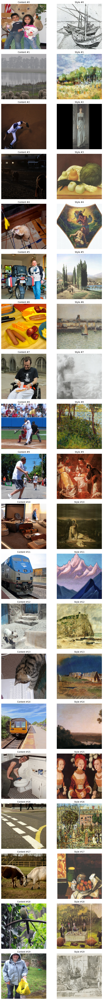

In [11]:
import matplotlib.pyplot as plt

IMAGENET_MEAN = torch.tensor([0.485, 0.456, 0.406]).view(3,1,1)
IMAGENET_STD  = torch.tensor([0.229, 0.224, 0.225]).view(3,1,1)

def denorm(x):
    """x: tensor [3,H,W] normalizado → tensor [H,W,3] en [0,1]"""
    x = x.cpu() * IMAGENET_STD + IMAGENET_MEAN
    x = x.clamp(0,1)
    return x.permute(1,2,0).numpy()

def show_examples(train_iter, num_pairs=5):
    """
    Muestra num_pairs de pares (content, style) obtenidos del DualBatchIterator.
    """
    x_content, x_style = next(iter(train_iter))
    num_pairs = min(num_pairs, x_content.size(0), x_style.size(0))

    plt.figure(figsize=(10, 4*num_pairs))

    for i in range(num_pairs):

        plt.subplot(num_pairs, 2, 2*i + 1)
        plt.imshow(denorm(x_content[i]))
        plt.title(f"Content #{i}")
        plt.axis("off")

        plt.subplot(num_pairs, 2, 2*i + 2)
        plt.imshow(denorm(x_style[i]))
        plt.title(f"Style #{i}")
        plt.axis("off")

    plt.tight_layout()
    plt.show()

show_examples(train_iter, num_pairs=20)